In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/nfl-player-contact-detection/test_baseline_helmets.csv
/kaggle/input/nfl-player-contact-detection/sample_submission.csv
/kaggle/input/nfl-player-contact-detection/train_baseline_helmets.csv
/kaggle/input/nfl-player-contact-detection/test_player_tracking.csv
/kaggle/input/nfl-player-contact-detection/train_player_tracking.csv
/kaggle/input/nfl-player-contact-detection/train_video_metadata.csv
/kaggle/input/nfl-player-contact-detection/test_video_metadata.csv
/kaggle/input/nfl-player-contact-detection/train_labels.csv
/kaggle/input/nfl-player-contact-detection/test/58172_003247_All29.mp4
/kaggle/input/nfl-player-contact-detection/test/58172_003247_Sideline.mp4
/kaggle/input/nfl-player-contact-detection/test/58172_003247_Endzone.mp4
/kaggle/input/nfl-player-contact-detection/test/58168_003392_Endzone.mp4
/kaggle/input/nfl-player-contact-detection/test/58168_003392_Sideline.mp4
/kaggle/input/nfl-player-contact-detection/test/58168_003392_All29.mp4
/kaggle/input/nfl-player-con

In [2]:
# libraries for plots
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.markers import MarkerStyle
import matplotlib.animation as animation

# from fast_ml.model_development import train_valid_test_split

import time
import warnings
warnings.filterwarnings("ignore")

# Video Display; IPython
import os
import cv2
import subprocess
import IPython
from IPython.display import Video, display

# Modeling
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV,train_test_split
from sklearn.metrics import accuracy_score,f1_score,roc_auc_score,roc_curve
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.metrics import matthews_corrcoef

import shap

from time import time

#### LOAD DATA

In [3]:
# Player tracking Data
tracking_tr = pd.read_csv("/kaggle/input/nfl-player-contact-detection/train_player_tracking.csv")

# Contact label data 
labels_tr = pd.read_csv("/kaggle/input/nfl-player-contact-detection/train_labels.csv")

# Helmet Baseline data 
baseline_helmets_tr = pd.read_csv("/kaggle/input/nfl-player-contact-detection/train_baseline_helmets.csv")

# Video MetaData
video_metadata_tr = pd.read_csv("/kaggle/input/nfl-player-contact-detection/train_video_metadata.csv")


## DATA DESCRIPTION

In [4]:
class data_info:
    def __init__(self,df):
        self.df = df

    def info(self): 
        
        # Counting no of rows 
        print(f'\nTotal Rows : {self.df.shape[0]} \n' + '--'*10 )
      
        # Counting no of columns
        print(f'\nTotal Columns : {self.df.shape[1]} \n' + '--'*10)
        
        # Extracting column names
        column_name =  self.df.columns 
        print(f'\nColumn Names\n' + '--'*10 +  f'\n{column_name} \n \n')
        
        # Data type info
        print(f'Data Summary\n' + '--'*10)
        data_summary = self.df.info() 
        
        # Total null values by each categories
        null_values = self.df.isnull().sum() 
        print(f'\nNull values\n' + '--'*10 + f'\n{null_values} \n \n')

        # Descriptive statistics
        describe =  self.df.describe() 
        print(f'\nDescriptive Statistics\n' + '--'*10 +  f'\n{describe} \n \n')
        
        # Top 5 rows
        head =  self.df.head() 
        print(f'\nTop 5 rows\n' + '--'*10 +  f'\n{head} \n \n')
        
        # Unique categories description
    def uniqueCategory(self):      
        
        # Number of Unique values in each column
        uniques_values = self.df.apply(lambda x : len(x.unique())) 
        print(f'Unique Values\n' + '--'*10 +  f'\n{uniques_values} \n \n')
        
        for i in self.df.columns: 
            if self.df[i].dtype == 'O':          # Columns having datatype object or categories in each column
                unique_category = set(self.df.loc[: , i])      # Unique categories in each columns
                
                if len(unique_category)>=100:
                    print(f'{i} -- {list(unique_category)[:10]}\n')
                    continue  #Taking only top 50 as more than 100 will messed up
                else:
                    print(f'\n{i} -- {unique_category}\n')
                    self.df[i].value_counts().plot(kind='bar')
                    plt.show()


Total Rows : 1353053 
--------------------

Total Columns : 17 
--------------------

Column Names
--------------------
Index(['game_play', 'game_key', 'play_id', 'nfl_player_id', 'datetime', 'step',
       'team', 'position', 'jersey_number', 'x_position', 'y_position',
       'speed', 'distance', 'direction', 'orientation', 'acceleration', 'sa'],
      dtype='object') 
 

Data Summary
--------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1353053 entries, 0 to 1353052
Data columns (total 17 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   game_play      1353053 non-null  object 
 1   game_key       1353053 non-null  int64  
 2   play_id        1353053 non-null  int64  
 3   nfl_player_id  1353053 non-null  int64  
 4   datetime       1353053 non-null  object 
 5   step           1353053 non-null  int64  
 6   team           1353053 non-null  object 
 7   position       1353053 non-null  object 
 8   jersey_num

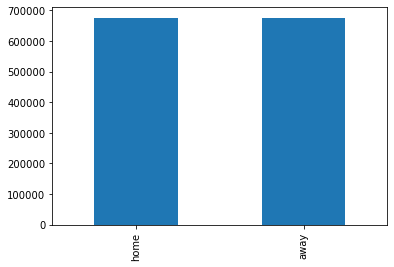


position -- {'LB', 'DE', 'FB', 'OT', 'T', 'HB', 'ILB', 'DL', 'SAF', 'K', 'TE', 'QB', 'G', 'CB', 'WR', 'DB', 'C', 'RB', 'OLB', 'DT', 'MLB', 'S', 'P', 'SS', 'OG', 'LS', 'NT', 'FS'}



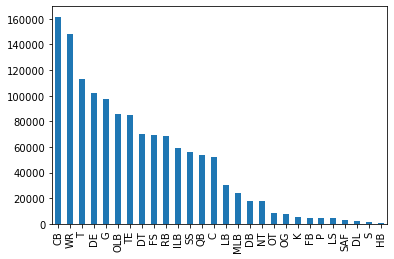

In [5]:
# tracking data
tracking_tr_obj = data_info(tracking_tr)

tracking_tr_obj.info()
tracking_tr_obj.uniqueCategory()

In [6]:
# labels 
labels_tr_obj = data_info(labels_tr)

labels_tr_obj.info()
labels_tr_obj.uniqueCategory()


Total Rows : 4721618 
--------------------

Total Columns : 7 
--------------------

Column Names
--------------------
Index(['contact_id', 'game_play', 'datetime', 'step', 'nfl_player_id_1',
       'nfl_player_id_2', 'contact'],
      dtype='object') 
 

Data Summary
--------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4721618 entries, 0 to 4721617
Data columns (total 7 columns):
 #   Column           Dtype 
---  ------           ----- 
 0   contact_id       object
 1   game_play        object
 2   datetime         object
 3   step             int64 
 4   nfl_player_id_1  int64 
 5   nfl_player_id_2  object
 6   contact          int64 
dtypes: int64(3), object(4)
memory usage: 252.2+ MB

Null values
--------------------
contact_id         0
game_play          0
datetime           0
step               0
nfl_player_id_1    0
nfl_player_id_2    0
contact            0
dtype: int64 
 


Descriptive Statistics
--------------------
               step  nfl_player_id_1     


Total Rows : 480 
--------------------

Total Columns : 7 
--------------------

Column Names
--------------------
Index(['game_play', 'game_key', 'play_id', 'view', 'start_time', 'end_time',
       'snap_time'],
      dtype='object') 
 

Data Summary
--------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 480 entries, 0 to 479
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   game_play   480 non-null    object
 1   game_key    480 non-null    int64 
 2   play_id     480 non-null    int64 
 3   view        480 non-null    object
 4   start_time  480 non-null    object
 5   end_time    480 non-null    object
 6   snap_time   480 non-null    object
dtypes: int64(2), object(5)
memory usage: 26.4+ KB

Null values
--------------------
game_play     0
game_key      0
play_id       0
view          0
start_time    0
end_time      0
snap_time     0
dtype: int64 
 


Descriptive Statistics
--------------------
   

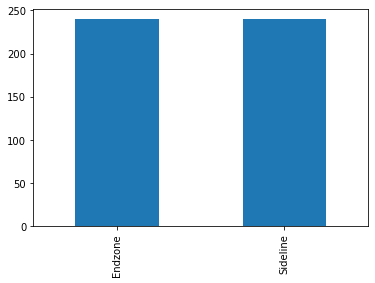

start_time -- ['2020-10-19T23:37:23.905Z', '2021-09-19T20:03:30.298Z', '2021-01-03T21:52:29.313Z', '2020-12-20T18:05:53.498Z', '2021-10-03T19:05:35.264Z', '2021-10-10T17:16:41.465Z', '2020-11-08T19:08:38.918Z', '2020-12-20T19:00:48.630Z', '2021-09-12T18:19:54.356Z', '2021-10-11T00:22:39.997Z']

end_time -- ['2020-09-27T19:17:11.822Z', '2020-11-01T21:22:08.291Z', '2020-09-13T20:09:23.445Z', '2021-01-03T20:31:49.370Z', '2020-11-16T00:22:19.570Z', '2021-10-03T17:04:34.058Z', '2021-09-12T18:20:06.524Z', '2020-10-27T00:54:36.945Z', '2021-10-03T17:16:56.810Z', '2020-10-04T18:14:36.367Z']

snap_time -- ['2020-10-12T02:24:57.994Z', '2020-11-22T23:24:25.492Z', '2020-12-02T21:56:24.540Z', '2020-11-01T18:05:37.403Z', '2021-09-19T17:07:21.015Z', '2020-11-26T22:07:16.245Z', '2021-09-19T18:22:04.249Z', '2021-09-26T22:52:35.802Z', '2021-09-19T21:27:31.856Z', '2020-09-13T20:09:16.306Z']



In [7]:
# video metadata 
video_metadata_tr_obj = data_info(video_metadata_tr)

video_metadata_tr_obj.info()
video_metadata_tr_obj.uniqueCategory()


Total Rows : 3783616 
--------------------

Total Columns : 12 
--------------------

Column Names
--------------------
Index(['game_play', 'game_key', 'play_id', 'view', 'video', 'frame',
       'nfl_player_id', 'player_label', 'left', 'width', 'top', 'height'],
      dtype='object') 
 

Data Summary
--------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3783616 entries, 0 to 3783615
Data columns (total 12 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   game_play      object
 1   game_key       int64 
 2   play_id        int64 
 3   view           object
 4   video          object
 5   frame          int64 
 6   nfl_player_id  int64 
 7   player_label   object
 8   left           int64 
 9   width          int64 
 10  top            int64 
 11  height         int64 
dtypes: int64(8), object(4)
memory usage: 346.4+ MB

Null values
--------------------
game_play        0
game_key         0
play_id          0
view             0
video            0
fra

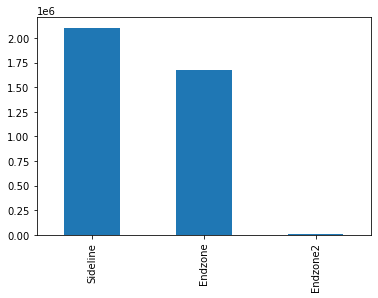

video -- ['58204_002864_Endzone.mp4', '58308_000965_Endzone.mp4', '58509_003605_Endzone.mp4', '58561_003088_Sideline.mp4', '58332_003535_Endzone.mp4', '58552_000452_Endzone.mp4', '58316_004059_Endzone.mp4', '58418_000608_Sideline.mp4', '58552_000100_Endzone.mp4', '58240_000086_Endzone.mp4']

player_label -- ['H76', 'V75', 'H16', 'V72', 'H93', 'H9', 'V61', 'H17', 'V82', 'V3']



In [8]:
# helmet detection from previos year competition
baseline_helmets_tr_obj = data_info(baseline_helmets_tr)

baseline_helmets_tr_obj.info()
baseline_helmets_tr_obj.uniqueCategory()

In [9]:
# Total number of gameplays and players 
print("Number of gameplays: ",len(tracking_tr['game_play'].unique()))
print("Number of players: ", len(tracking_tr['nfl_player_id'].unique()))

Number of gameplays:  240
Number of players:  1687


<AxesSubplot:>

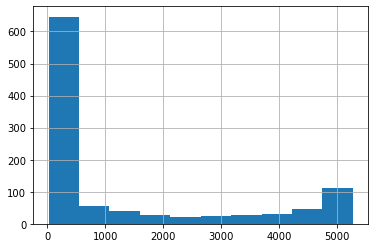

In [10]:
# Step: A number representing each timestep for each play, starting at 0 at the moment of the play starting, and incrementing by 1 every 0.1 seconds.
tracking_tr['step'].value_counts().hist()

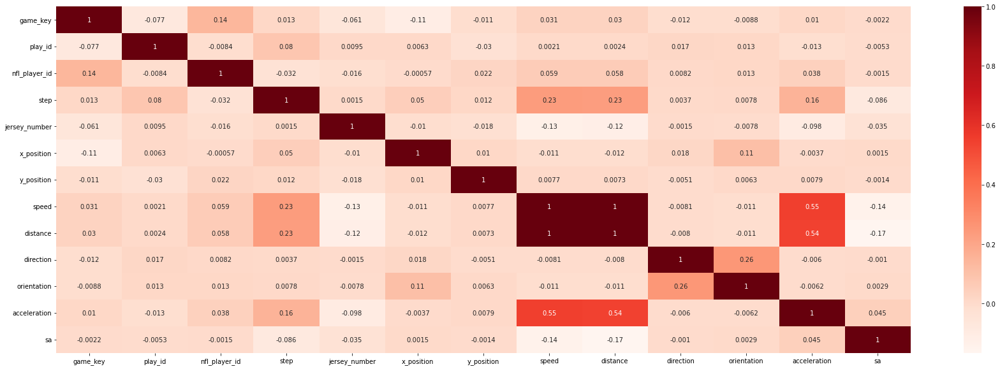

In [11]:
# Correlation plot for Tracking Data
plt.figure(figsize=(30,10))
sns.heatmap(tracking_tr.corr(),annot=True, cmap="Reds")
plt.show()

### Target Variable Distribution

<AxesSubplot:title={'center':'Contact Label Distribution'}, ylabel='contact'>

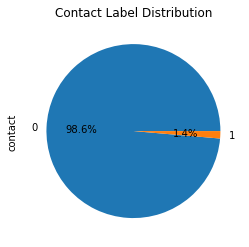

In [12]:
labels_tr['contact'].value_counts().plot.pie(autopct    = '%1.1f%%', title = 'Contact Label Distribution')

#### The data is highly unbalanced 

<AxesSubplot:>

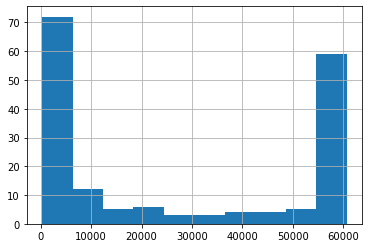

In [13]:
# Step: A number representing each timestep for each play, starting at 0 at the moment of the play starting, and incrementing by 1 every 0.1 seconds.
labels_tr['step'].value_counts().hist()

<AxesSubplot:xlabel='step', ylabel='Count'>

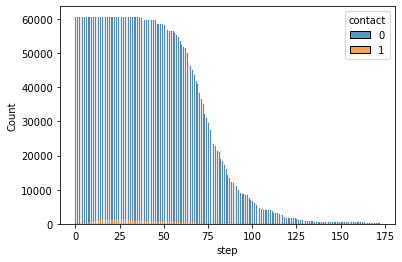

In [14]:
# plt.plot(labels_tr['step'],labels_tr['contact'])
sns.histplot(binwidth=0.5, x="step", hue="contact", data=labels_tr[['step','contact']], stat="count", multiple="stack")

<AxesSubplot:title={'center':'step'}, xlabel='contact'>

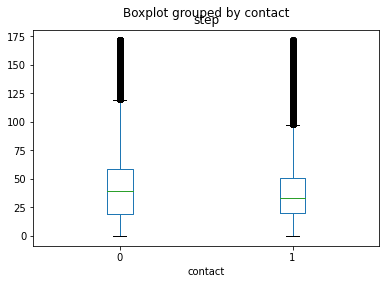

In [15]:
labels_tr.boxplot(by ='contact', column =['step'], grid = False)

## Single Gameplay Visualisation

In [16]:
#############################################
# DISPLAYING SYNCED VIDEOS                  #
# FOR A SINGLE GAMEPLAY                     #
#############################################

class gameplay:
    
    def __init__(self,gameplay_id,view):
        self.gameplay_id = gameplay_id
        self.view = view
    
    def play_video(self,video_path):
        frac = 0.65 # scaling factor for display 
#         print(video_path)
        display(
            Video(data=video_path, embed=True, height=int(720*frac), width=int(1280*frac))
        )


    def annotate_video_with_helmets(self, baseline_boxes:pd.DataFrame, verbose=True) -> str:
        """
        Annotates a video with baseline model boxes and labels.
        """
        
        video_path = '/kaggle/input/nfl-player-contact-detection/train/' + str(self.gameplay_id) + '_' + str(self.view) + '.mp4'
#         print(video_path)
        
        video_name = str(self.gameplay_id) + '_' + str(self.view) + '.mp4'
        play_name = self.gameplay_id
        HELMET_COLOR = (0, 0, 0) # black
        baseline_boxes = baseline_boxes.query("video==@video_name")

        # verbose
        if verbose==True:
            print(f"Running for {video_name}")

        # VideoCapture Object
        cap  = cv2.VideoCapture(video_path)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        fps = cap.get(cv2.CAP_PROP_FPS)

        # VideoWriter Object
        output_path = "labeled_" + video_name
        tmp_output_path = "tmp_" + output_path
        out = cv2.VideoWriter(tmp_output_path, cv2.VideoWriter_fourcc(*'MP4V'), 
                              fps, (width, height))

        # check  if camera opened successfully
        if cap.isOpened() == False:
            print('Error opening file')

        # read until video is complete
        frame  = 1
        while(cap.isOpened()):
            # capture frame by frame
            ret, img = cap.read()

            if ret==True:
                # add play_name text
                cv2.putText(img, play_name,
                           (int(0.01*width), int(0.05*height)),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                           )

                # add frame counter
                cv2.putText(img, "Frame: "+str(frame),
                           (int(0.75*width), int(0.05*height)),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                           )

                # adding helmet bounding boxes and player tags
                bbox_set = baseline_boxes.query("frame==@frame")
                for i, annot in enumerate(zip(np.array(bbox_set[['player_label','left','width','top','height']]))):
                    player_label, bbox_left, bbox_width, bbox_top, bbox_height = annot[0]
                    # add helmet bbox
                    cv2.rectangle(img, 
                                  (bbox_left,bbox_top), (bbox_left+bbox_width, bbox_top+bbox_height),
                                  HELMET_COLOR,
                                  1
                                 )
                    # add player label
                    cv2.putText(img, player_label,
                           (bbox_left+10, bbox_top+10),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                           )

                frame += 1
                out.write(img) 

            # break the loop   
            else: 
                break


        out.release()

        # Not all browsers support the codec, we will re-load the file at tmp_output_path
        # and convert to a codec that is more broadly readable using ffmpeg
        if os.path.exists(output_path):
            os.remove(output_path)
        subprocess.run(
            [
                "ffmpeg",
                "-i",
                tmp_output_path,
                "-crf",
                "18",
                "-preset",
                "veryfast",
                "-hide_banner",
                "-loglevel",
                "error",
                "-vcodec",
                "libx264",
                output_path,
            ]
        )
        os.remove(tmp_output_path)

        return output_path



    def create_football_field(self,fig, ax, line_color='black', field_color='white'):
        """
        Function that plots the football field for viewing players.
        """

        # set field dimensions
        plt.xlim(0,120)
        plt.ylim(0,53.3)

        # adding rectangles to the field
        for i in range(12):
            rect = patches.Rectangle((10*i,0), 10, 53.3, linewidth=1, edgecolor=line_color, facecolor=field_color)
            ax.add_patch(rect)

        # configure axes
        ax.tick_params(
            axis='both',
            which='both',
            direction='in',
            pad=-40,
            length = 5,
            bottom=True,
            top=True,
            labeltop=True,
            labelbottom=True,
            left=False,
            right=False,
            labelleft=False,
            labelright=False,
            color=line_color)

        # set ticks on the side of the field
        ax.set_xticks([i for i in range(10,111)])

        # setting yard marking
        label_set = []
        for i in range(1,10):
            if i<=5:
                label_set += [" " for j in range(9)] + [str(i*10)]
            else:
                label_set += [" " for j in range(9)] + [str((10-i)*10)]
        label_set =  [" "] + label_set + [" " for j in range(10)]
        ax.set_xticklabels(label_set, fontsize=20, color=line_color)


        return fig, ax


    def populate_field(self, step:np.int64, player_tracking_data:pd.DataFrame, home_color:str='violet', away_color:str='coral'):
        """
        populates the field with player tracking data of a play_name and step.
        """
        play_name = self.gameplay_id
        
        # subset data to current play and step 
        step_info = player_tracking_data.query("game_play==@play_name and step==@step ").copy()

        # create new field
        fig, ax= plt.subplots(figsize=(12, 5.33))
        fig, ax  = self.create_football_field(fig, ax)

        # set title
        ax.set_title(f'Tracking data for {play_name} at step {step}')

        # populate field with players
        for row in step_info.iterrows():
            if row[1]['team'] == 'home':
                color = home_color
            else:
                color = away_color
            marker1 = MarkerStyle(r'$\spadesuit$')
            marker1._transform.rotate_deg(360-row[1]['orientation'])
            ax.scatter(row[1]['x_position'], row[1]['y_position'], marker=marker1, s=150, color=color)    

        plt.close()
        return fig, ax


    def animate(self, i:int, player_tracking_data:pd.DataFrame, frames, home_color:str='violet', away_color:str='coral'):
        """
        Function to animate player tracking data
        """
        
        play_name = self.gameplay_id
        # create fresh field
        ax.clear()
        self.create_football_field(fig, ax)

        # find appropriate
        play_info = player_tracking_data.query("game_play==@play_name").copy()
        step_list = np.linspace(play_info['step'].min(), play_info['step'].max(), frames)
        step = int(step_list[i])

        # subset data to step info
        step_info = play_info.query("step==@step").copy()

        # iterate step info to populate field
        for row in step_info.iterrows():
            if row[1]['team'] == 'home':
                color = home_color
            else:
                color = away_color
            marker1 = MarkerStyle(r'$\spadesuit$')
            marker1._transform.rotate_deg(360-row[1]['orientation'])
            ax.scatter(row[1]['x_position'], row[1]['y_position'], marker=marker1, s=150, color=color)

        # set axis title
        ax.set_title(f'Tracking data for {play_name} at step {step}')


    def join_helmets_contact(self, labels, helmets, meta, view, fps=59.94):
        """
        Joins helmets and labels for a given play_name, Results can be 
        used for visualizing labels.
        Returns a dataframe with the joint dataframe, duplicating rows if 
        multiple contacts occur.
        """
        play_name = self.gameplay_id
        
        # labels and helmets for specific play_name
        labels = labels.query('game_play==@play_name').copy()
        helmets = helmets.query('game_play==@play_name and view==@view').copy()

        meta['start_time'] = pd.to_datetime(meta['start_time'])
        # start time of the play
        start_time = meta.query('game_play==@play_name and view==@view')['start_time'].values[0]
        print(start_time)
    #     print(type(start_time))


        # converting frame into datetime in helmets data for merge
        helmets['datetime'] = pd.to_timedelta(helmets['frame'] * (1/fps), unit='s') + start_time
        helmets['datetime'] = pd.to_datetime(helmets['datetime'], utc=True)

        helmets['datetime_ngs'] = pd.DatetimeIndex(helmets['datetime'] + pd.to_timedelta(50, 'ms')).floor('100ms').values
        helmets['datetime_ngs'] = pd.to_datetime(helmets['datetime_ngs'], utc=True)


        # converting datetime in lables for merge
        labels['datetime_ngs'] = pd.to_datetime(labels['datetime'], utc=True)

        # merge labels and helmets using 'datetime_ngs'
        play_data = helmets.merge(labels.query('contact==1')[['datetime_ngs', 'nfl_player_id_1', 'nfl_player_id_2', 'contact_id']],
                                 left_on = ['datetime_ngs', 'nfl_player_id'],
                                 right_on = ['datetime_ngs', 'nfl_player_id_1'],
                                 how = 'left')

        return play_data


    def annotate_video_with_contact_labels(self, baseline_boxes:pd.DataFrame, verbose=True) -> str:
        """
        Annotates a video with baseline model boxes and labels.
        Helmet boxes are colored based on the contact label.
        """
        
        video_path = '/kaggle/input/nfl-player-contact-detection/train/' + str(self.gameplay_id) + '_' + str(self.view) + '.mp4'
        video_name = video_path.split('/')[-1]
        play_name = video_name.split('.')[0]
        play_name = '_'.join(play_name.split('_')[:-1])
        HELMET_COLOR = (0, 0, 0) # black
        baseline_boxes = baseline_boxes.query("game_play==@play_name").copy()

        # verbose
        if verbose==True:
            print(f"Running for {video_name}")

        # VideoCapture Object
        cap  = cv2.VideoCapture(video_path)
        width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        fps = cap.get(cv2.CAP_PROP_FPS)

        # VideoWriter Object
        output_path = "labeled_" + video_name
        tmp_output_path = "tmp_" + output_path
        out = cv2.VideoWriter(tmp_output_path, cv2.VideoWriter_fourcc(*'MP4V'), 
                              fps, (width, height))

        # check  if camera opened successfully
        if cap.isOpened() == False:
            print('Error opening file')

        # read until video is complete
        frame  = 1
        while(cap.isOpened()):
            # capture frame by frame
            ret, img = cap.read()

            if ret==True:
                # add play_name text
                cv2.putText(img, play_name,
                           (int(0.01*width), int(0.05*height)),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                           )

                # add frame counter
                cv2.putText(img, "Frame: "+str(frame),
                           (int(0.75*width), int(0.05*height)),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                           )

                # adding helmet bounding boxes, player tags and contact labels
                bbox_set = baseline_boxes.query("frame==@frame")
                 # ensuring null values (no contact) come first, the player-player contact and then player-ground contact
                bbox_set = bbox_set.sort_values(by='nfl_player_id_2', na_position='first', ascending=True)
                for idx, row in bbox_set.iterrows():
                    if pd.isnull(row.contact_id):
                        # add black (no contact) helmet bbox
                        cv2.rectangle(img, 
                                      (int(row.left),int(row.top)), 
                                      (int(row.left+row.width), int(row.top+row.height)),
                                      HELMET_COLOR, # black
                                      1
                                     )
                    else:
                        if row.nfl_player_id_2=='G':
                            # add red (contact with ground)helmet bbox
                            cv2.rectangle(img, 
                                          (int(row.left),int(row.top)), 
                                          (int(row.left+row.width), int(row.top+row.height)),
                                          (0, 0, 225), # red
                                          2
                                         )
                        else:
                            # add green (contact with another player) helmet bbox
                            cv2.rectangle(img, 
                                          (int(row.left),int(row.top)), 
                                          (int(row.left+row.width), int(row.top+row.height)),
                                          (0, 255, 0), # green
                                          2
                                         )

                            # check if player 2 in view
                            row_player_2 = bbox_set.query('nfl_player_id_2==@row.nfl_player_id_2')
                            if len(row_player_2)==0:
                                pass
                            else:
                                # add green (contact with another player) helmet bbox (for player 2)
                                cv2.rectangle(img, 
                                              (int(row_player_2.left.values[0]),int(row_player_2.top.values[0])), 
                                              (int(row_player_2.left.values[0]+row_player_2.width.values[0]), int(row_player_2.top.values[0]+row_player_2.height.values[0])),
                                              (0, 255, 0), # green
                                              2
                                             )
                                # add blue connecting line between players in contact
                                cv2.line(img,
                                        (int(row.left+(row.width/2)), int(row.top+(row.height/2))),
                                        (int(row_player_2.left.values[0]+(row_player_2.width.values[0]/2)), int(row_player_2.top.values[0]+(row_player_2.height.values[0]/2))),
                                        (255, 0, 0), # blue
                                        2
                                        )

                    # add player label
                    cv2.putText(img, row.player_label,
                            (int(row.left+10), int(row.top+10)),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            1,
                            HELMET_COLOR,
                            1
                            )


                frame += 1
                out.write(img) 

            # break the loop   
            else: 
                break


        out.release()

        # Not all browsers support the codec, we will re-load the file at tmp_output_path
        # and convert to a codec that is more broadly readable using ffmpeg
        if os.path.exists(output_path):
            os.remove(output_path)
        subprocess.run(
            [
                "ffmpeg",
                "-i",
                tmp_output_path,
                "-crf",
                "18",
                "-preset",
                "veryfast",
                "-hide_banner",
                "-loglevel",
                "error",
                "-vcodec",
                "libx264",
                output_path,
            ]
        )
        os.remove(tmp_output_path)

        return output_path

### Endzone view for Game play: 58168_003392

In [17]:
play_name = '58168_003392'
view = 'Endzone'
video_path = '/kaggle/input/nfl-player-contact-detection/train/' + play_name+ '_' + view + '.mp4'
game_play_obj = gameplay(play_name,view)

game_play_obj.play_video(video_path)

### Endzone view with **helmets annotated** for Game play: 58168_003392

In [18]:
path = game_play_obj.annotate_video_with_helmets(baseline_helmets_tr)
game_play_obj.play_video(path)

Running for 58168_003392_Endzone.mp4


OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


### Endzone view from **player tracking data** for Game play: 58168_003392

In [19]:
# arguments
df = tracking_tr.copy()

# total number of frames at 10hz
frames = len(df.query("game_play==@play_name")['step'].unique())

# frequency modifier factor [min_val:1, max_val:10] (reduce this for smoother tracking but longer rendering time)
freq_mod_fac = 5
# to reduce rendering time we change the frequency to (10/freq_mod_fac)Hz
frames = int(frames/freq_mod_fac)
interval_ms = int(100*freq_mod_fac)

# initialize figure
fig, ax = plt.subplots(figsize=(12, 5.33))
fig, ax = game_play_obj.create_football_field(fig, ax)


# animate
anim = animation.FuncAnimation(fig, game_play_obj.animate, fargs=( df, frames),frames=frames, repeat=False, interval=interval_ms)

# embed html video to notebook
video = anim.to_html5_video()
html = IPython.display.HTML(video)
display(html)
plt.close()


### 

### Endzone view with **helmet and contact annotated** for Game play: 58168_003392

In [20]:
# video_path = '/kaggle/input/nfl-player-contact-detection/train/58168_003392_Endzone.mp4'
# play_name = '58168_003392'
# view = 'Endzone'

gp = game_play_obj.join_helmets_contact(labels_tr, baseline_helmets_tr, video_metadata_tr, view=view)
path = game_play_obj.annotate_video_with_contact_labels(gp)
game_play_obj.play_video(path)

2020-09-11T03:01:43.134000000
Running for 58168_003392_Endzone.mp4


OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


#### **Black helmet** boxes indicate that the player is not in contact. A unique number (home/visiting combined with jersey number) is shown next to their helmet.\n
#### **Green helmet** boxes indicate that the player is in contact with one or more players.
#### **Red helmet** boxes indicates that the player is in contact with the ground (and possibly another player).
#### **Blue** lines show the link between players in contact with each other.

## MODELING USING ONLY TRACKING DATA

In [21]:
# P2P only 
data = labels_tr[labels_tr['nfl_player_id_2'].str.contains('G') == False].copy()

target = 'contact'
test_size = 0.15
labels_X_train, labels_X_test, labels_y_train, labels_y_test = train_test_split(data.loc[:, data.columns != target], data[target], test_size=test_size, stratify = data[target], random_state=42)

In [22]:
# data prep
class prepare_data_for_model_input:
    
    def __init__(self,tracking_tr, labels_tr):
        self.tracking_tr = tracking_tr
        self.labels_tr = labels_tr
        
    def one_hot(self,df, col):
        one_hot = pd.get_dummies(df[col], prefix = col)
        # Drop column as it is now encoded
        df = df.drop(col,axis = 1)
        # Join the encoded df
        df = df.join(one_hot)
    
        return df
    
    def join(self, player_attributes, p2p_only = True):
        
#         # Player to Player contact only
#         if p2p_only:
#             data = self.labels_tr[self.labels_tr['nfl_player_id_2'].str.contains('G') == False].copy()
#         else:
#             data = self.labels_tr.copy()
        
        data = self.labels_tr.copy()
        # segregating attributes of players to extract from tracking data
        player_attributes_1 = []
        player_attributes_2 = []

        for col in player_attributes:
            player_attributes_1.append(col + '_1')
            player_attributes_2.append(col + '_2')
        
        # Adding player 1 attributes
        data = pd.merge(self.tracking_tr, data, left_on=['game_play','datetime','step','nfl_player_id'],right_on=['game_play','datetime','step','nfl_player_id_1'], how='right')
        data.rename(columns = dict(zip(player_attributes, player_attributes_1)), inplace=True)
#         print("columns after rename: " ,data.columns)

        # del unnecessary columns
        del data['game_key'],data['play_id'], data['nfl_player_id'], data['jersey_number']

#         print(data.columns)
        
        # adding player 2 attributes 
        data['nfl_player_id_2'] = data['nfl_player_id_2'].astype(int)
        data = pd.merge(tracking_tr, data, left_on=['game_play','datetime','step','nfl_player_id'],right_on=['game_play','datetime','step','nfl_player_id_2'], how='right')

        del data['game_play'], data['game_key'],data['play_id'], data['nfl_player_id'], data['jersey_number']
#         print(data.columns)
        data.rename(columns=dict(zip(player_attributes, player_attributes_2)), inplace=True)
#         print( "After renaming: ",data.columns)
        
        # del unnecessary columns
        del data['datetime'], data['contact_id']  
        
        # ONE HOT ENCODING
#         del data['team_1'], data['team_2'], data['position_1'], data['position_2']
        data = self.one_hot(data,'team_1')
        data = self.one_hot(data,'team_2')

        data = self.one_hot(data,'position_1')
        data = self.one_hot(data,'position_2')
        
        return data

In [23]:
class model:
    
    def __init__(self, model = 'xgb'):
        self.model = model

        
#     def split_data(self, data, target = 'contact',test_size=0.15):
#         X_train, X_test, y_train, y_test = train_test_split(data.loc[:, data.columns != target], data[target], test_size=test_size, stratify = data['contact'], random_state=42)
        
        
    def train(self, X_train, X_test, y_train, y_test, param_grid, n_iter = 40, cv = 3,eval_metric='auc', use_gpu = True, verbose = 2):
        
        self.X_train = X_train
        self.X_test = X_test
        self.y_train = y_train
        self.y_test = y_test
        
        if self.model == 'xgb':
            if use_gpu == True:
                xgb_base = XGBClassifier(tree_method='gpu_hist',eval_metric=eval_metric)
                xgb_random = RandomizedSearchCV(estimator = xgb_base, param_distributions = param_grid, 
                                   n_iter = n_iter, cv = cv, verbose = verbose, random_state = 42, 
                                   n_jobs = 1)
            else:
                xgb_base = XGBClassifier(eval_metric=eval_metric)
                xgb_random = RandomizedSearchCV(estimator = xgb_base, param_distributions = param_grid, 
                                   n_iter = n_iter, cv = cv, verbose = verbose, random_state = 42, 
                                   n_jobs = -1)

            # Fit the random search model
            xgb_random.fit(self.X_train, self.y_train)
            
            # View the best parameters from the random search
            best_param  = xgb_random.best_params_
            
            self.best_model = xgb_random
            
            return xgb_random
        
        
    def score(self):

        y_pred = self.best_model.predict(self.X_test)
        predictions = [round(value) for value in y_pred]

        self.predictions = predictions

        return predictions

    def evaluate(self):

        y_pred = self.predictions
        y_test = self.y_test

        print("****Classification report****")
        print(classification_report(y_test,y_pred))

        print("****roc_auc_score**** ")
        print(roc_auc_score(y_test,y_pred))

        print("****Confusion Matrix****")
        print(pd.DataFrame(confusion_matrix(y_test,y_pred)))

        disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test,y_pred))
        disp.plot()

        plt.show()

        print("****Matthews correlation coef****")
        print(matthews_corrcoef(y_test,y_pred))           

In [24]:
# Attributes taken from Tracking Data 
player_attributes = [
 'team',
 'position',
 'x_position',
 'y_position',
 'speed',
 'distance',
 'direction',
 'orientation',
 'acceleration',
 'sa']


# data prep
train_obj = prepare_data_for_model_input(tracking_tr, labels_X_train)

train = train_obj.join(player_attributes)

print(train.columns)

test_obj = prepare_data_for_model_input(tracking_tr, labels_X_test)

test = test_obj.join(player_attributes)

print(test.columns)


Index(['step', 'x_position_2', 'y_position_2', 'speed_2', 'distance_2',
       'direction_2', 'orientation_2', 'acceleration_2', 'sa_2',
       'x_position_1', 'y_position_1', 'speed_1', 'distance_1', 'direction_1',
       'orientation_1', 'acceleration_1', 'sa_1', 'nfl_player_id_1',
       'nfl_player_id_2', 'team_1_away', 'team_1_home', 'team_2_away',
       'team_2_home', 'position_1_C', 'position_1_CB', 'position_1_DB',
       'position_1_DE', 'position_1_DL', 'position_1_DT', 'position_1_FB',
       'position_1_FS', 'position_1_G', 'position_1_HB', 'position_1_ILB',
       'position_1_K', 'position_1_LB', 'position_1_LS', 'position_1_MLB',
       'position_1_NT', 'position_1_OG', 'position_1_OLB', 'position_1_OT',
       'position_1_P', 'position_1_QB', 'position_1_RB', 'position_1_S',
       'position_1_SAF', 'position_1_SS', 'position_1_T', 'position_1_TE',
       'position_1_WR', 'position_2_C', 'position_2_CB', 'position_2_DB',
       'position_2_DE', 'position_2_DL', 'positio

In [25]:
!nvidia-smi

Mon Feb 13 06:07:21 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.82.01    Driver Version: 470.82.01    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [26]:
#setting grid of selected parameters for iteration
param_grid = {'gamma': [0,0.1,0.2,0.4,0.8,1.6,3.2,6.4,12.8,25.6,51.2,102.4, 200],
              'learning_rate': [0.01, 0.03, 0.06, 0.1, 0.15, 0.2, 0.25, 0.300000012, 0.4, 0.5, 0.6, 0.7],
              'max_depth': [5,6,7,8,9,10,11,12,13,14],
              'n_estimators': [50,65,80,100,115,130,150],
              'reg_alpha': [0,0.1,0.2,0.4,0.8,1.6,3.2,6.4,12.8,25.6,51.2,102.4,200],
              'reg_lambda': [0,0.1,0.2,0.4,0.8,1.6,3.2,6.4,12.8,25.6,51.2,102.4,200]}

#### XGBoost – implementation of the gradient boosting ensemble algorithm. Boosting trains models in succession, with each new model being trained to correct the errors made by the previous ones. Models are added sequentially until no further improvements can be made.

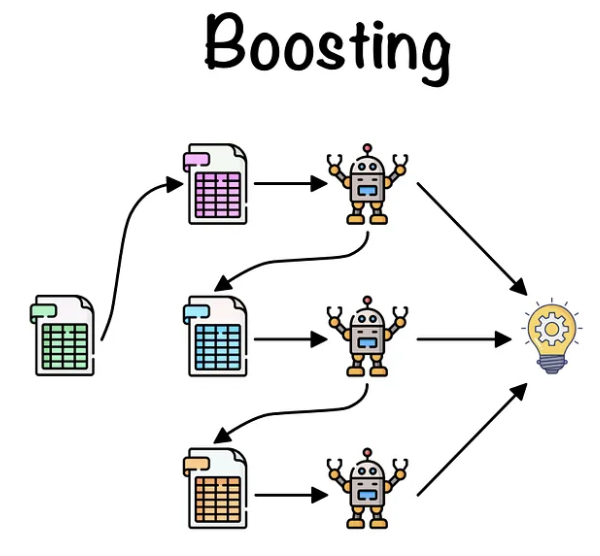

#### Why XGBoost?
    -Parallelization: sequential tree building using parallelized implementation. 
    -Regularization: In-built regularization parameters to prevent overfitting. 
    -Cross-validation: In-built method for cross validation
    -Handling Missing Values: done automatically (not required here)
    -Multi-collinearity: Stable in the presence of multicollinearity.

In [27]:
model_obj = model(model = 'xgb')
train_samples= len(train) #1000
test_samples= len(test) #100

X_train = train[:train_samples]
X_test = test[:test_samples]
y_train = labels_y_train[:train_samples]
y_test = labels_y_test[:test_samples]

xgb = model_obj.train(X_train = train[:train_samples], X_test = test[:test_samples],  y_train = labels_y_train[:train_samples], y_test = labels_y_test[:test_samples], param_grid=param_grid, n_iter = 40, cv=3, use_gpu = True, verbose=False)

****Classification report****
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    639492
           1       0.94      0.75      0.84      7156

    accuracy                           1.00    646648
   macro avg       0.97      0.88      0.92    646648
weighted avg       1.00      1.00      1.00    646648

****roc_auc_score**** 
0.8760640668990765
****Confusion Matrix****
        0     1
0  639155   337
1    1770  5386


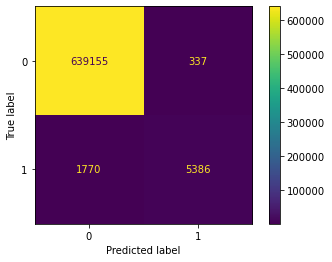

****Matthews correlation coef****
0.8400963134386126


In [28]:
model_obj.score()
model_obj.evaluate()

In [29]:
xgb.best_estimator_.save_model("/kaggle/working/xgb.json")

Text(0.5, 0, 'Xgboost Feature Importance')

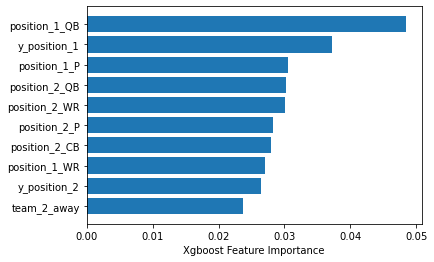

In [30]:
# Plotting feature importance 
sorted_idx = xgb.best_estimator_.feature_importances_.argsort()
sorted_idx = sorted_idx[len(sorted_idx)-10:]
plt.barh(train.columns[sorted_idx], xgb.best_estimator_.feature_importances_[sorted_idx])
plt.xlabel("Xgboost Feature Importance")

In [31]:
t1 = time()
sample_shap = int(len(X_test)*0.05)
# Fits the explainer

explainer = shap.Explainer(xgb.predict, X_test[:sample_shap])
t2 = time()

print("time taken: ", t2-t1)

time taken:  0.00772404670715332


In [32]:
t1 = time()

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test[:sample_shap])

t2 = time()
print("time taken: ", t2-t1)

Permutation explainer: 32333it [1:12:12,  7.45it/s]


time taken:  4333.634911060333


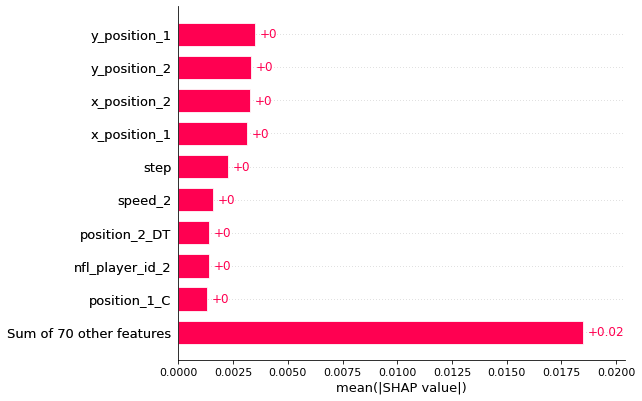

In [33]:
shap.plots.bar(shap_values)

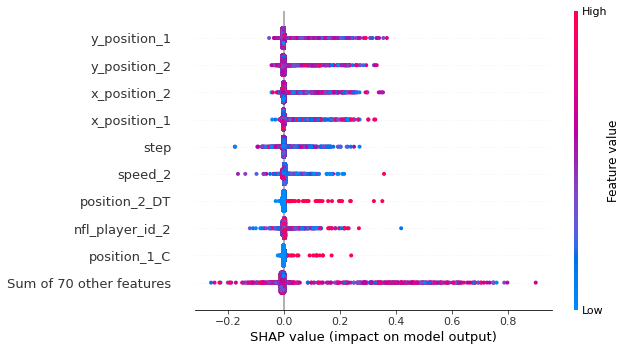

In [34]:
shap.plots.beeswarm(shap_values)